<a href="https://colab.research.google.com/github/mdsalem17/scientific-guide-notebooks/blob/main/Pix2Pix/Pix2Pix.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Pix2Pix

## Introduction
In this notebook, we will write a generative model based on the paper [*Image-to-Image Translation with Conditional Adversarial Networks*](https://arxiv.org/abs/1611.07004) by Isola et al. 2017, also known as Pix2Pix.

We will be training a model that can convert aerial satellite imagery ("input") into map routes ("output"), as was done in the original paper. you can find the pix2pix datasets here: http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/. Since the architecture for the generator is a U-Net, which we've already implemented (with minor changes), the emphasis of this notebook will be on the loss function. So that we can see outputs more quickly, we'll be training our model starting from a pre-trained checkpoint.

In [ ]:
#Downloading the data
!wget http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz
!tar -xzf maps.tar.gz

--2021-11-11 18:43:46--  http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 250242400 (239M) [application/x-gzip]
Saving to: ‘maps.tar.gz’

maps.tar.gz         100%[===================>] 238.65M  1.16MB/s    in 3m 25s  

2021-11-11 18:47:12 (1.16 MB/s) - ‘maps.tar.gz’ saved [250242400/250242400]



## Getting Started
We will start by importing libraries, defining a visualization function, and getting the pre-trained Pix2Pix checkpoint.

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import VOCSegmentation
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

#### U-Net Code

The U-Net code will be much like the code we wrote for the GAN-based data augmentation, but with optional dropout and batchnorm. The structure is changed slightly for Pix2Pix, so that the final image is closer in size to the input image.

In [ ]:
def crop(image, new_shape):
    '''
    Function for cropping an image tensor: Given an image tensor and the new shape,
    crops to the center pixels (assumes that the input's size and the new size are
    even numbers).
    Parameters:
        image: image tensor of shape (batch size, channels, height, width)
        new_shape: a torch.Size object with the shape we want x to have
    '''
    middle_height = image.shape[2] // 2
    middle_width = image.shape[3] // 2
    starting_height = middle_height - new_shape[2] // 2
    final_height = starting_height + new_shape[2]
    starting_width = middle_width - new_shape[3] // 2
    final_width = starting_width + new_shape[3]
    cropped_image = image[:, :, starting_height:final_height, starting_width:final_width]
    return cropped_image

class ContractingBlock(nn.Module):
    '''
    ContractingBlock Class
    Performs two convolutions followed by a max pool operation.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_dropout=False, use_bn=True):
        super(ContractingBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(input_channels * 2, input_channels * 2, kernel_size=3, padding=1)
        self.activation = nn.LeakyReLU(0.2)
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)
        if use_bn:
            self.batchnorm = nn.BatchNorm2d(input_channels * 2)
        self.use_bn = use_bn
        if use_dropout:
            self.dropout = nn.Dropout()
        self.use_dropout = use_dropout

    def forward(self, x):
        '''
        Function for completing a forward pass of ContractingBlock: 
        Given an image tensor, completes a contracting block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.batchnorm(x)
        if self.use_dropout:
            x = self.dropout(x)
        x = self.activation(x)
        x = self.conv2(x)
        if self.use_bn:
            x = self.batchnorm(x)
        if self.use_dropout:
            x = self.dropout(x)
        x = self.activation(x)
        x = self.maxpool(x)
        return x

class ExpandingBlock(nn.Module):
    '''
    ExpandingBlock Class:
    Performs an upsampling, a convolution, a concatenation of its two inputs,
    followed by two more convolutions with optional dropout
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_dropout=False, use_bn=True):
        super(ExpandingBlock, self).__init__()
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.conv1 = nn.Conv2d(input_channels, input_channels // 2, kernel_size=2)
        self.conv2 = nn.Conv2d(input_channels, input_channels // 2, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(input_channels // 2, input_channels // 2, kernel_size=2, padding=1)
        if use_bn:
            self.batchnorm = nn.BatchNorm2d(input_channels // 2)
        self.use_bn = use_bn
        self.activation = nn.ReLU()
        if use_dropout:
            self.dropout = nn.Dropout()
        self.use_dropout = use_dropout

    def forward(self, x, skip_con_x):
        '''
        Function for completing a forward pass of ExpandingBlock: 
        Given an image tensor, completes an expanding block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
            skip_con_x: the image tensor from the contracting path (from the opposing block of x)
                    for the skip connection
        '''
        x = self.upsample(x)
        x = self.conv1(x)
        skip_con_x = crop(skip_con_x, x.shape)
        x = torch.cat([x, skip_con_x], axis=1)
        x = self.conv2(x)
        if self.use_bn:
            x = self.batchnorm(x)
        if self.use_dropout:
            x = self.dropout(x)
        x = self.activation(x)
        x = self.conv3(x)
        if self.use_bn:
            x = self.batchnorm(x)
        if self.use_dropout:
            x = self.dropout(x)
        x = self.activation(x)
        return x

class FeatureMapBlock(nn.Module):
    '''
    FeatureMapBlock Class
    The final layer of a U-Net - 
    maps each pixel to a pixel with the correct number of output dimensions
    using a 1x1 convolution.
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels):
        super(FeatureMapBlock, self).__init__()
        self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=1)

    def forward(self, x):
        '''
        Function for completing a forward pass of FeatureMapBlock: 
        Given an image tensor, returns it mapped to the desired number of channels.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv(x)
        return x

class UNet(nn.Module):
    '''
    UNet Class
    A series of 4 contracting blocks followed by 4 expanding blocks to 
    transform an input image into the corresponding paired image, with an upfeature
    layer at the start and a downfeature layer at the end.
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels, hidden_channels=32):
        super(UNet, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_dropout=True)
        self.contract2 = ContractingBlock(hidden_channels * 2, use_dropout=True)
        self.contract3 = ContractingBlock(hidden_channels * 4, use_dropout=True)
        self.contract4 = ContractingBlock(hidden_channels * 8)
        self.contract5 = ContractingBlock(hidden_channels * 16)
        self.contract6 = ContractingBlock(hidden_channels * 32)
        self.expand0 = ExpandingBlock(hidden_channels * 64)
        self.expand1 = ExpandingBlock(hidden_channels * 32)
        self.expand2 = ExpandingBlock(hidden_channels * 16)
        self.expand3 = ExpandingBlock(hidden_channels * 8)
        self.expand4 = ExpandingBlock(hidden_channels * 4)
        self.expand5 = ExpandingBlock(hidden_channels * 2)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        self.sigmoid = torch.nn.Sigmoid()

    def forward(self, x):
        '''
        Function for completing a forward pass of UNet: 
        Given an image tensor, passes it through U-Net and returns the output.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        x4 = self.contract4(x3)
        x5 = self.contract5(x4)
        x6 = self.contract6(x5)
        x7 = self.expand0(x6, x5)
        x8 = self.expand1(x7, x4)
        x9 = self.expand2(x8, x3)
        x10 = self.expand3(x9, x2)
        x11 = self.expand4(x10, x1)
        x12 = self.expand5(x11, x0)
        xn = self.downfeature(x12)
        return self.sigmoid(xn)

## PatchGAN Discriminator

Next, we will define a discriminator based on the contracting path of the U-Net to allow us to evaluate the realism of the generated images. Remember that the discriminator outputs a one-channel matrix of classifications instead of a single value. Our discriminator's final layer will simply map from the final number of hidden channels to a single prediction for every pixel of the layer before it.

In [ ]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Structured like the contracting path of the U-Net, the discriminator will
    output a matrix of values classifying corresponding portions of the image as real or fake. 
    Parameters:
        input_channels: the number of image input channels
        hidden_channels: the initial number of discriminator convolutional filters
    '''
    def __init__(self, input_channels, hidden_channels=8):
        super(Discriminator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_bn=False)
        self.contract2 = ContractingBlock(hidden_channels * 2)
        self.contract3 = ContractingBlock(hidden_channels * 4)
        self.contract4 = ContractingBlock(hidden_channels * 8)
        self.final = nn.Conv2d(hidden_channels * 16, 1, kernel_size=1)

    def forward(self, x, y):
        x = torch.cat([x, y], axis=1)
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        x4 = self.contract4(x3)
        xn = self.final(x4)
        return xn

In [ ]:
# UNIT TEST
test_discriminator = Discriminator(10, 1)
assert tuple(test_discriminator(
    torch.randn(1, 5, 256, 256), 
    torch.randn(1, 5, 256, 256)
).shape) == (1, 1, 16, 16)
print("Success!")

Success!


## Training Preparation
<!-- We'll be using the same U-Net as in the previous assignment, but we'll write another discriminator and change the loss to make it a GAN. -->

Now we can begin putting everything together for training. We start by defining some new parameters as well as the ones we are familiar with:
  *   **real_dim**: the number of channels of the real image and the number expected in the output image
  *   **adv_criterion**: an adversarial loss function to keep track of how well the GAN is fooling the discriminator and how well the discriminator is catching the GAN
  *   **recon_criterion**: a loss function that rewards similar images to the ground truth, which "reconstruct" the image
  *   **lambda_recon**: a parameter for how heavily the reconstruction loss should be weighed
  *   **n_epochs**: the number of times we iterate through the entire dataset when training
  *   **input_dim**: the number of channels of the input image
  *   **display_step**: how often to display/visualize the images
  *   **batch_size**: the number of images per forward/backward pass
  *   **lr**: the learning rate
  *   **target_shape**: the size of the output image (in pixels)
  *   **device**: the device type

In [ ]:
import torch.nn.functional as F
# New parameters
adv_criterion = nn.BCEWithLogitsLoss() 
recon_criterion = nn.L1Loss() 
lambda_recon = 200

n_epochs = 20
input_dim = 3
real_dim = 3
display_step = 200
batch_size = 4
lr = 0.0002
target_shape = 256
device = 'cuda'

We will then pre-process the images of the dataset to make sure they're all the same size and that the size change due to U-Net layers is accounted for. 

In [ ]:
transform = transforms.Compose([
    transforms.ToTensor(),
])

import torchvision
dataset = torchvision.datasets.ImageFolder("maps", transform=transform)

Next, we can initialize our generator (U-Net) and discriminator, as well as their optimizers. Finally, we will also load our pre-trained model.

In [12]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [18]:
path = "/content/drive/MyDrive/scientific-guide-notebooks/GAN_notebooks/Pix2Pix/"

In [21]:
gen = UNet(input_dim, real_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(input_dim + real_dim).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# change pretrained to False => training the model from scratch
pretrained = False
if pretrained:
    loaded_state = torch.load(path+"pix2pix_5400.pth")
    gen.load_state_dict(loaded_state["gen"])
    gen_opt.load_state_dict(loaded_state["gen_opt"])
    disc.load_state_dict(loaded_state["disc"])
    disc_opt.load_state_dict(loaded_state["disc_opt"])
else:
    gen = gen.apply(weights_init)
    disc = disc.apply(weights_init)

While there are some changes to the U-Net architecture for Pix2Pix, the most important distinguishing feature of Pix2Pix is its adversarial loss. We will be implementing that here!

In [ ]:
def get_gen_loss(gen, disc, real, condition, adv_criterion, recon_criterion, lambda_recon):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        gen: the generator; takes the condition and returns potential images
        disc: the discriminator; takes images and the condition and
          returns real/fake prediction matrices
        real: the real images (e.g. maps) to be used to evaluate the reconstruction
        condition: the source images (e.g. satellite imagery) which are used to produce the real images
        adv_criterion: the adversarial loss function; takes the discriminator 
                  predictions and the true labels and returns a adversarial 
                  loss (which we aim to minimize)
        recon_criterion: the reconstruction loss function; takes the generator 
                    outputs and the real images and returns a reconstructuion 
                    loss (which we aim to minimize)
        lambda_recon: the degree to which the reconstruction loss should be weighted in the sum
    '''
    # Steps: 1) Generate the fake images, based on the conditions.
    #        2) Evaluate the fake images and the condition with the discriminator.
    #        3) Calculate the adversarial and reconstruction losses.
    #        4) Add the two losses, weighting the reconstruction loss appropriately.
    fake = gen(condition)
    disc_fake_hat = disc(fake, condition)
    gen_adv_loss = adv_criterion(disc_fake_hat, torch.ones_like(disc_fake_hat))
    gen_rec_loss = recon_criterion(real, fake)
    gen_loss = gen_adv_loss + lambda_recon * gen_rec_loss
    
    return gen_loss

In [ ]:
# UNIT TEST
def test_gen_reasonable(num_images=10):
    gen = torch.zeros_like
    disc = lambda x, y: torch.ones(len(x), 1)
    real = None
    condition = torch.ones(num_images, 3, 10, 10)
    adv_criterion = torch.mul
    recon_criterion = lambda x, y: torch.tensor(0)
    lambda_recon = 0
    assert get_gen_loss(gen, disc, real, condition, adv_criterion, recon_criterion, lambda_recon).sum() == num_images

    disc = lambda x, y: torch.zeros(len(x), 1)
    assert torch.abs(get_gen_loss(gen, disc, real, condition, adv_criterion, recon_criterion, lambda_recon)).sum() == 0

    adv_criterion = lambda x, y: torch.tensor(0)
    recon_criterion = lambda x, y: torch.abs(x - y).max()
    real = torch.randn(num_images, 3, 10, 10)
    lambda_recon = 2
    gen = lambda x: real + 1
    assert torch.abs(get_gen_loss(gen, disc, real, condition, adv_criterion, recon_criterion, lambda_recon) - 2) < 1e-4

    adv_criterion = lambda x, y: (x + y).max() + x.max()
    assert torch.abs(get_gen_loss(gen, disc, real, condition, adv_criterion, recon_criterion, lambda_recon) - 3) < 1e-4
test_gen_reasonable()
print("Success!")

Success!


## Pix2Pix Training

Finally, we can train the model and see some of our maps!

  0%|          | 0/549 [00:00<?, ?it/s]

Pretrained initial state


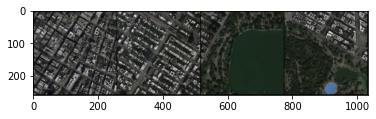

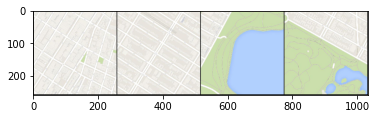

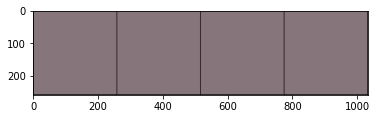

Epoch 0: Step 200: Generator (U-Net) loss: 77.23272016525267, Discriminator loss: 0.6437874475121494


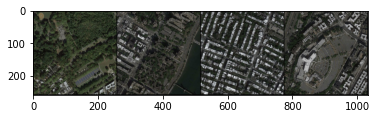

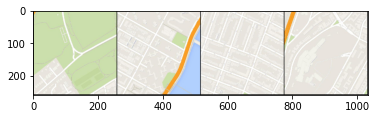

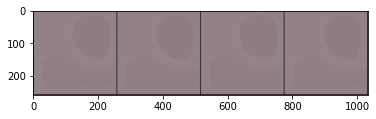

Epoch 0: Step 400: Generator (U-Net) loss: 61.58867193222048, Discriminator loss: 0.4844802005589011


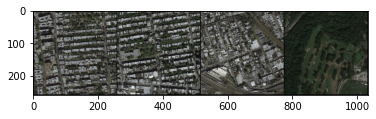

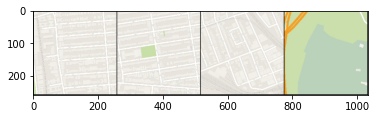

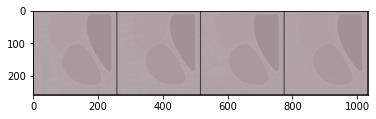

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 1: Step 600: Generator (U-Net) loss: 37.86097708702088, Discriminator loss: 0.28327198907732964


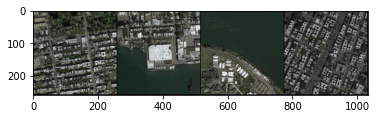

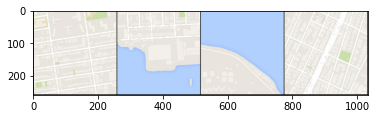

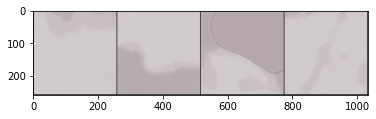

Epoch 1: Step 800: Generator (U-Net) loss: 20.160288443565367, Discriminator loss: 0.27365824170410635


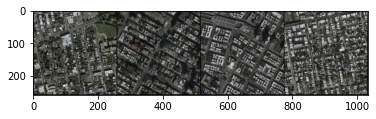

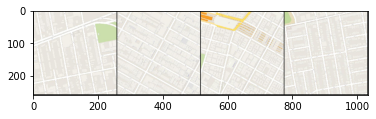

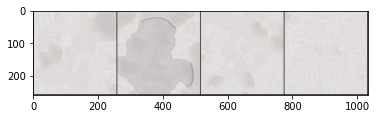

Epoch 1: Step 1000: Generator (U-Net) loss: 14.1914787864685, Discriminator loss: 0.09662734640762202


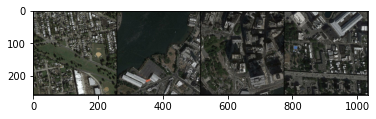

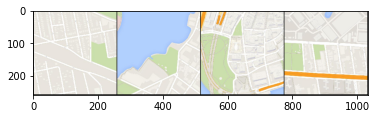

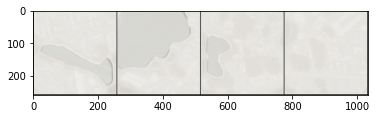

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 2: Step 1200: Generator (U-Net) loss: 13.505218911170957, Discriminator loss: 0.15278995852917435


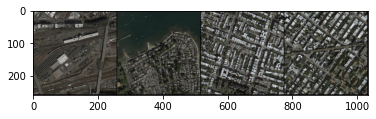

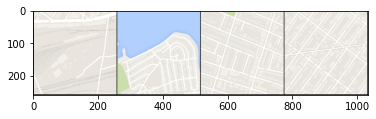

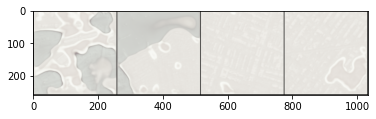

Epoch 2: Step 1400: Generator (U-Net) loss: 12.88110834121704, Discriminator loss: 0.3973373345658185


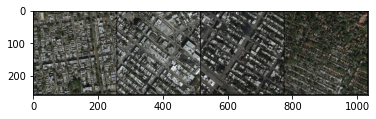

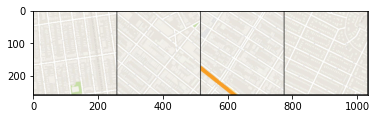

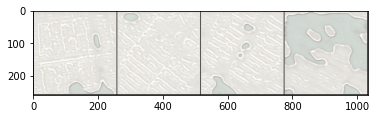

Epoch 2: Step 1600: Generator (U-Net) loss: 12.860074577331542, Discriminator loss: 0.34478482481092215


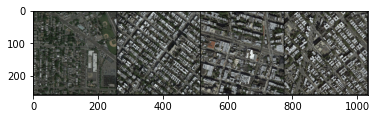

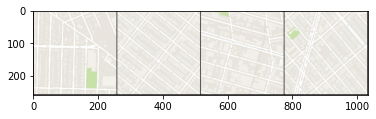

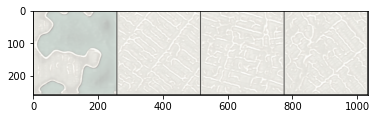

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 3: Step 1800: Generator (U-Net) loss: 13.056612124443047, Discriminator loss: 0.17744176639243972


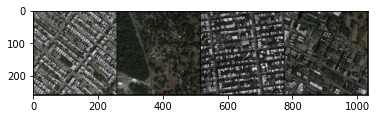

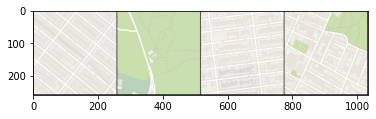

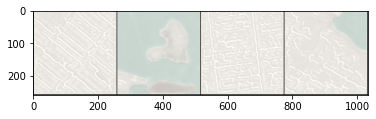

Epoch 3: Step 2000: Generator (U-Net) loss: 13.24732751369476, Discriminator loss: 0.103175363689661


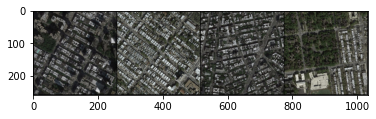

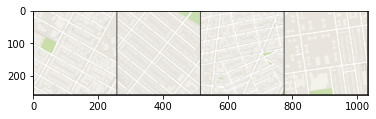

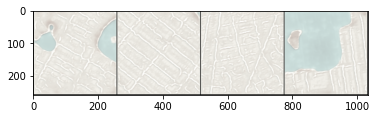

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 4: Step 2200: Generator (U-Net) loss: 13.089505987167364, Discriminator loss: 0.1874925003200769


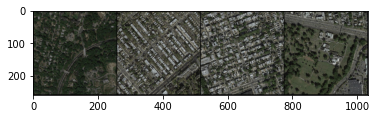

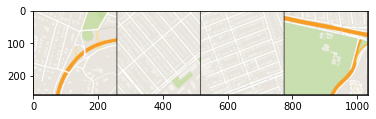

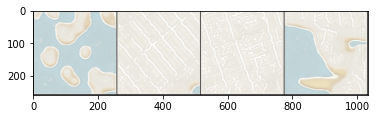

Epoch 4: Step 2400: Generator (U-Net) loss: 12.758211321830753, Discriminator loss: 0.15128988360986123


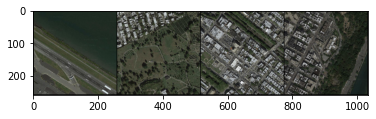

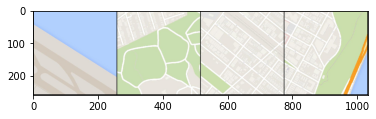

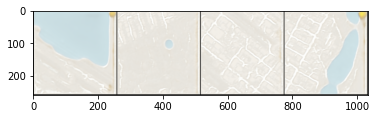

Epoch 4: Step 2600: Generator (U-Net) loss: 12.663246707916265, Discriminator loss: 0.23836275424808268


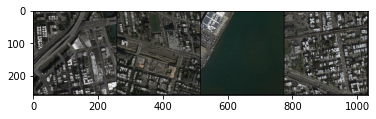

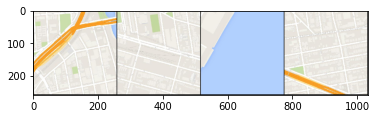

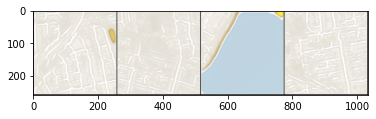

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 5: Step 2800: Generator (U-Net) loss: 11.969362821578983, Discriminator loss: 0.257058981154114


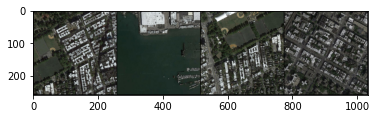

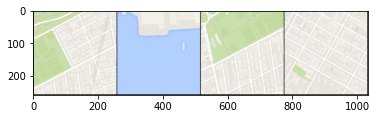

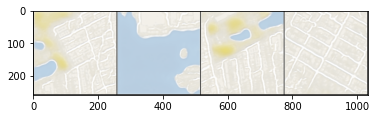

Epoch 5: Step 3000: Generator (U-Net) loss: 12.033338732719413, Discriminator loss: 0.22358748186379676


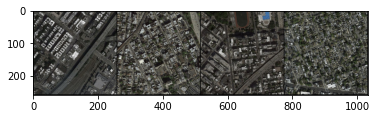

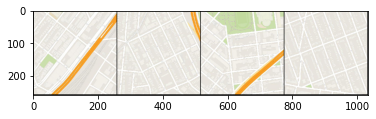

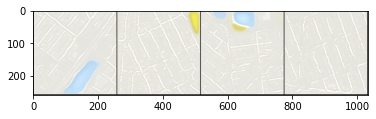

Epoch 5: Step 3200: Generator (U-Net) loss: 12.089203770160674, Discriminator loss: 0.2527886086888611


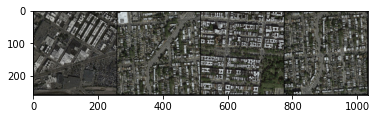

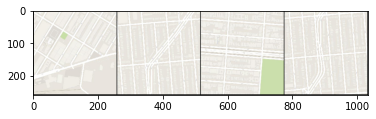

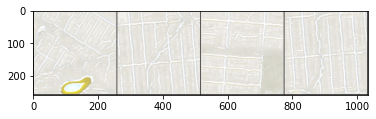

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 6: Step 3400: Generator (U-Net) loss: 11.680568289756774, Discriminator loss: 0.3480862183310093


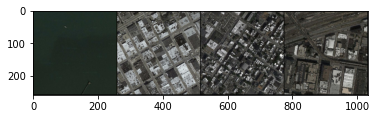

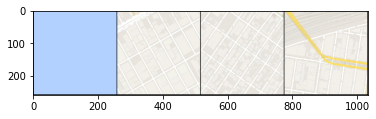

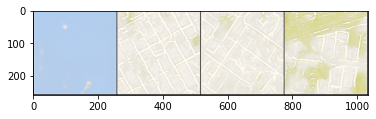

Epoch 6: Step 3600: Generator (U-Net) loss: 11.300387024879457, Discriminator loss: 0.3320685341581705


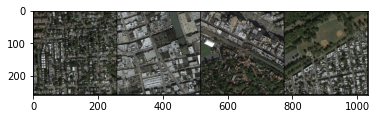

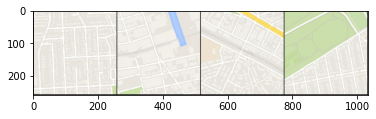

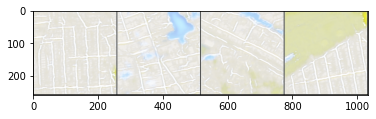

Epoch 6: Step 3800: Generator (U-Net) loss: 11.07345608949661, Discriminator loss: 0.3863512160256504


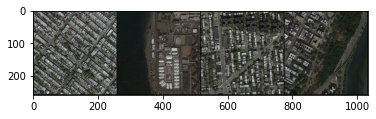

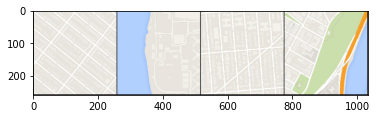

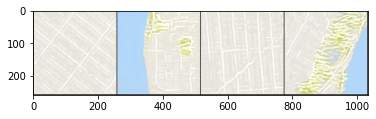

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 7: Step 4000: Generator (U-Net) loss: 11.040740351676941, Discriminator loss: 0.32554158521816146


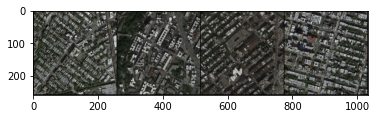

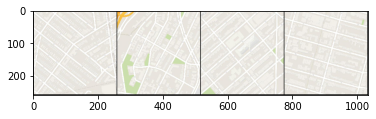

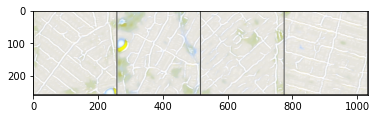

Epoch 7: Step 4200: Generator (U-Net) loss: 10.371084539890296, Discriminator loss: 0.39981845498085034


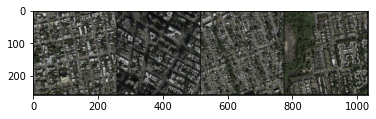

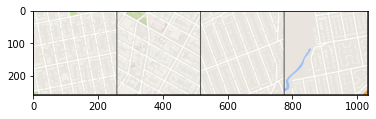

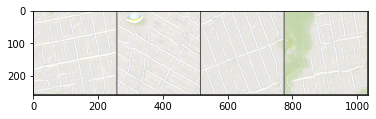

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 8: Step 4400: Generator (U-Net) loss: 10.318016443252555, Discriminator loss: 0.3396547434292732


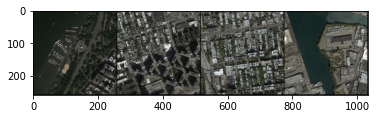

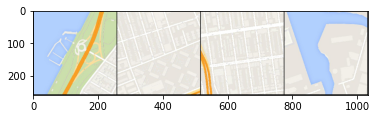

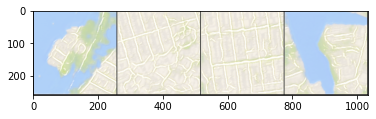

Epoch 8: Step 4600: Generator (U-Net) loss: 10.388691432476046, Discriminator loss: 0.3425897072814406


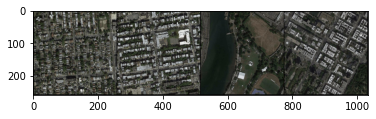

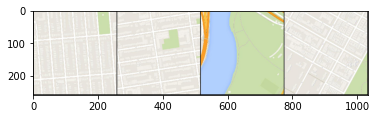

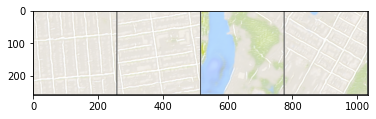

Epoch 8: Step 4800: Generator (U-Net) loss: 10.320871689319617, Discriminator loss: 0.37872178643941884


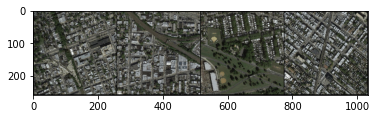

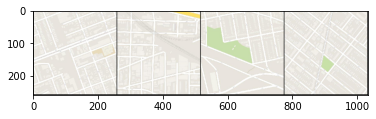

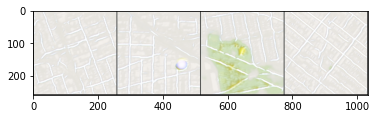

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 9: Step 5000: Generator (U-Net) loss: 10.900661137104036, Discriminator loss: 0.30001728026196356


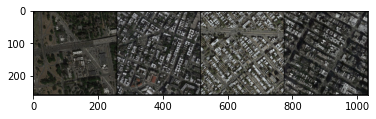

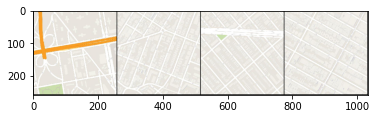

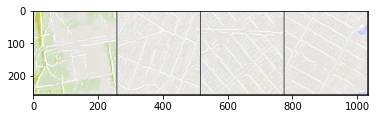

Epoch 9: Step 5200: Generator (U-Net) loss: 10.688388409614559, Discriminator loss: 0.2906222815811634


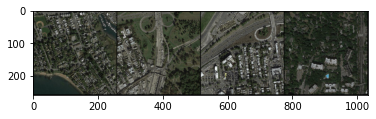

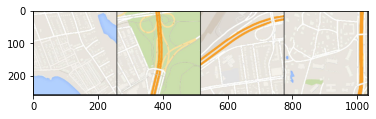

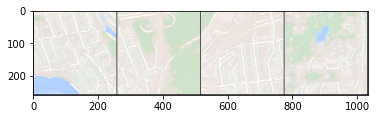

Epoch 9: Step 5400: Generator (U-Net) loss: 10.74069734096527, Discriminator loss: 0.25188870439305894


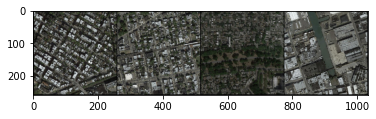

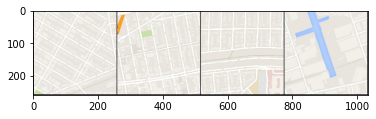

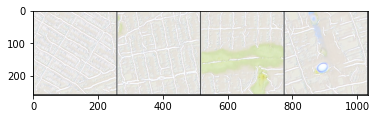

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 10: Step 5600: Generator (U-Net) loss: 10.938937044143684, Discriminator loss: 0.2578338282834737


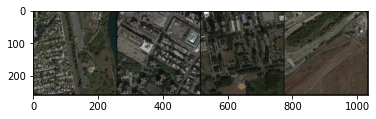

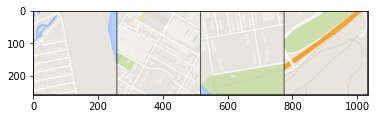

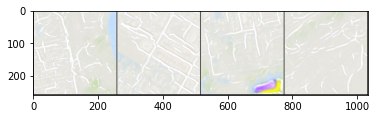

Epoch 10: Step 5800: Generator (U-Net) loss: 10.902466135025017, Discriminator loss: 0.2525430104136465


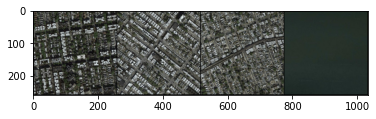

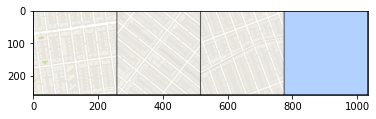

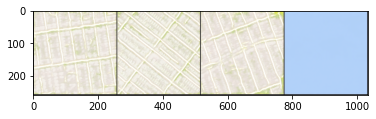

Epoch 10: Step 6000: Generator (U-Net) loss: 10.65290500164032, Discriminator loss: 0.29372185827232905


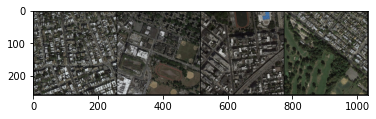

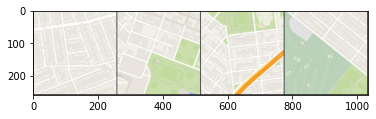

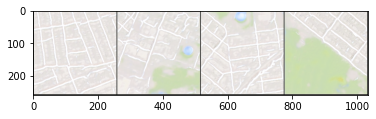

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 11: Step 6200: Generator (U-Net) loss: 10.348818881511686, Discriminator loss: 0.2874289823975414


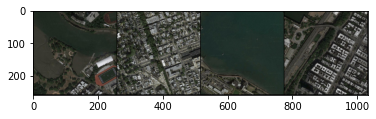

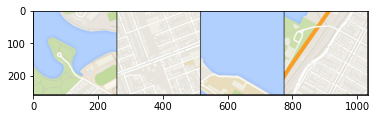

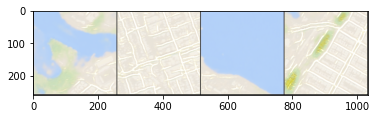

Epoch 11: Step 6400: Generator (U-Net) loss: 10.479729080200201, Discriminator loss: 0.2934180412068962


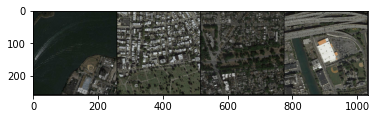

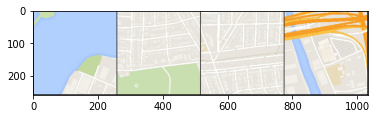

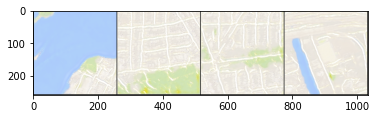

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 12: Step 6600: Generator (U-Net) loss: 10.132947254180921, Discriminator loss: 0.2931536844186484


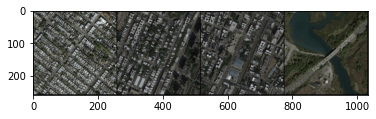

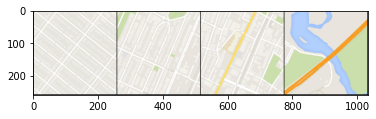

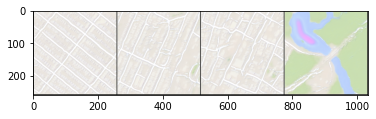

Epoch 12: Step 6800: Generator (U-Net) loss: 10.408650858402252, Discriminator loss: 0.28072642592713215


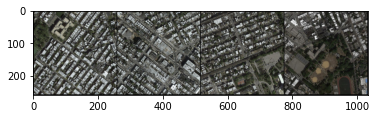

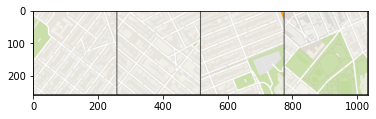

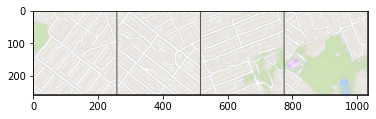

Epoch 12: Step 7000: Generator (U-Net) loss: 10.259672574996944, Discriminator loss: 0.32689007262699293


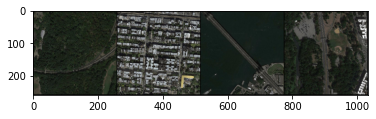

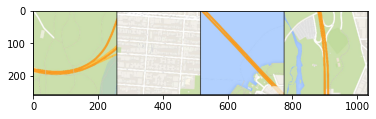

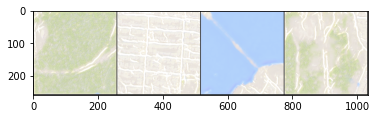

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 13: Step 7200: Generator (U-Net) loss: 10.188772053718562, Discriminator loss: 0.30590808276087056


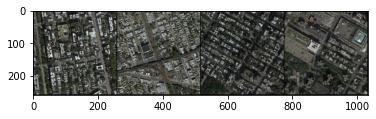

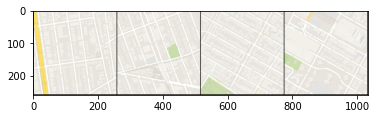

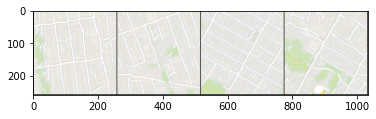

Epoch 13: Step 7400: Generator (U-Net) loss: 10.013163599967953, Discriminator loss: 0.3407016507349911


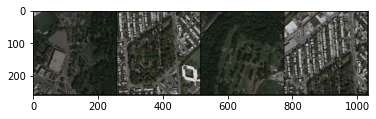

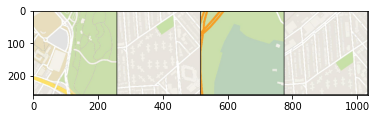

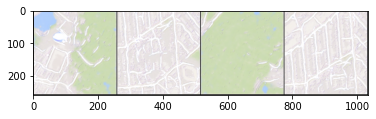

Epoch 13: Step 7600: Generator (U-Net) loss: 10.350483973026273, Discriminator loss: 0.28245339080691334


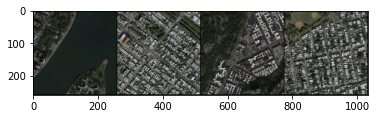

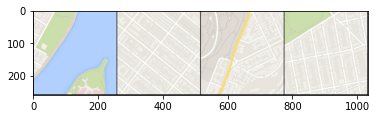

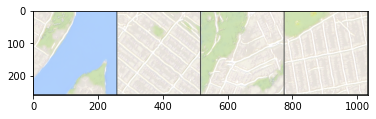

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 14: Step 7800: Generator (U-Net) loss: 10.10051005601883, Discriminator loss: 0.34708129873499266


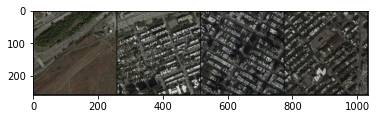

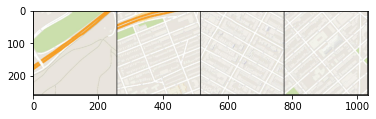

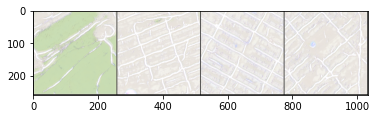

Epoch 14: Step 8000: Generator (U-Net) loss: 10.42594427585602, Discriminator loss: 0.26306439278647303


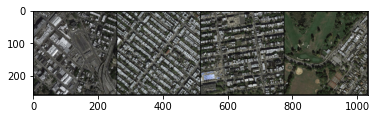

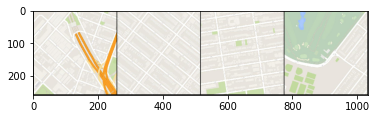

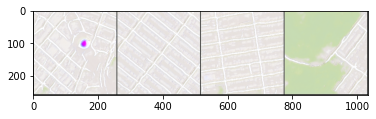

Epoch 14: Step 8200: Generator (U-Net) loss: 10.304940602779391, Discriminator loss: 0.2799492644425482


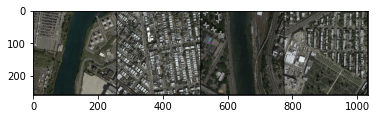

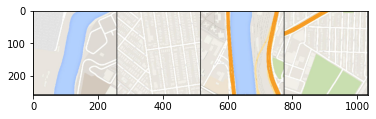

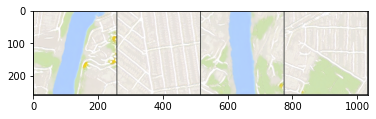

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 15: Step 8400: Generator (U-Net) loss: 10.4340587234497, Discriminator loss: 0.2709871147759259


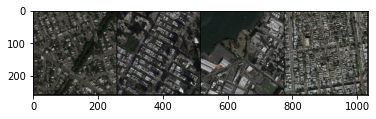

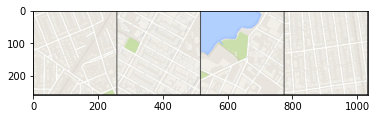

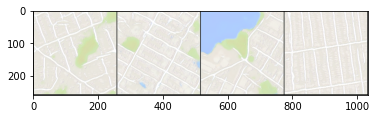

Epoch 15: Step 8600: Generator (U-Net) loss: 10.474580109119414, Discriminator loss: 0.27229728543199583


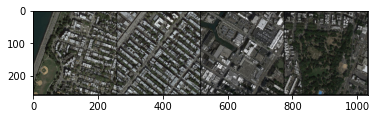

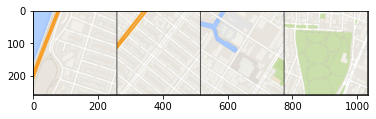

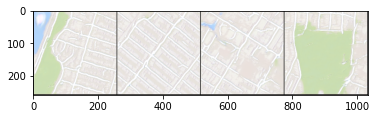

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 16: Step 8800: Generator (U-Net) loss: 10.007954912185678, Discriminator loss: 0.26700504003092645


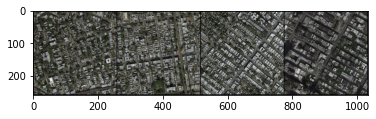

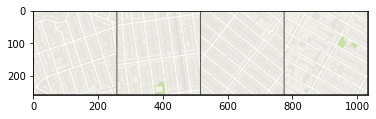

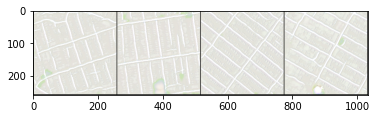

Epoch 16: Step 9000: Generator (U-Net) loss: 10.443556160926816, Discriminator loss: 0.23814635398797687


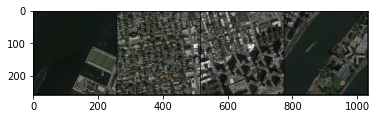

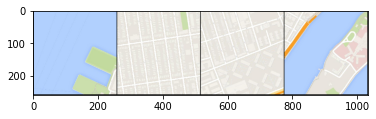

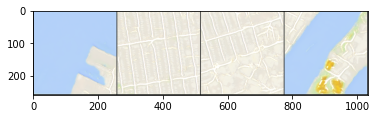

Epoch 16: Step 9200: Generator (U-Net) loss: 10.598100173473346, Discriminator loss: 0.2174448064994067


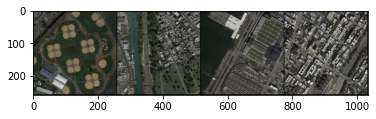

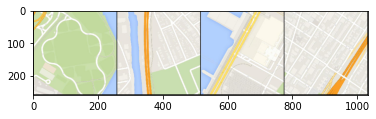

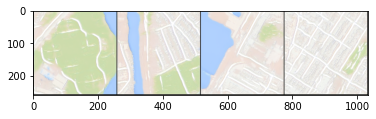

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 17: Step 9400: Generator (U-Net) loss: 11.125781583786013, Discriminator loss: 0.19208841673098503


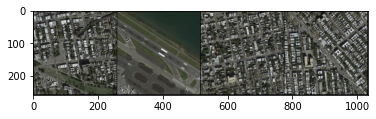

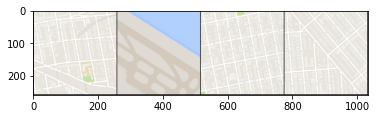

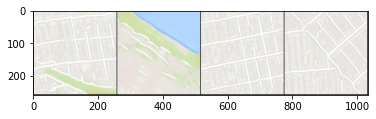

Epoch 17: Step 9600: Generator (U-Net) loss: 10.34584400177002, Discriminator loss: 0.2794813638273627


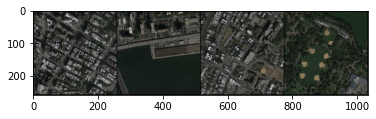

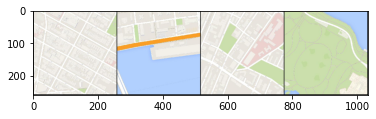

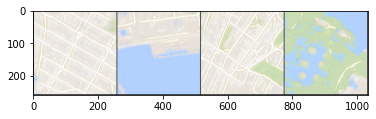

Epoch 17: Step 9800: Generator (U-Net) loss: 10.714179079532613, Discriminator loss: 0.21258454005233945


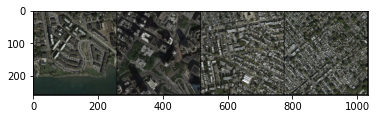

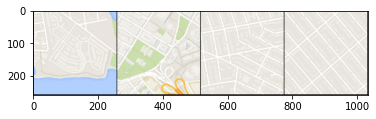

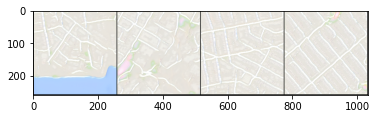

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 18: Step 10000: Generator (U-Net) loss: 11.115520472526551, Discriminator loss: 0.1673936173319818


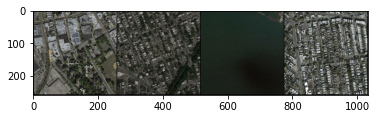

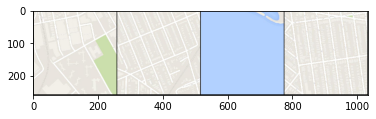

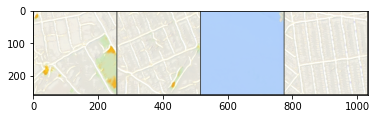

Epoch 18: Step 10200: Generator (U-Net) loss: 11.324291207790372, Discriminator loss: 0.11045689114369457


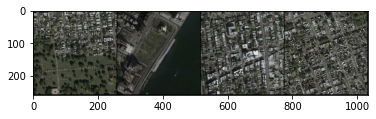

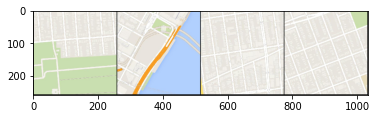

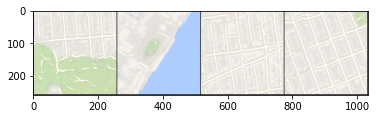

Epoch 18: Step 10400: Generator (U-Net) loss: 11.437779190540315, Discriminator loss: 0.09860243278555572


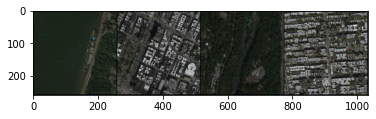

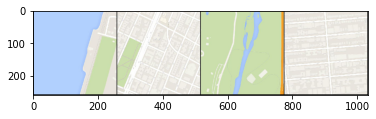

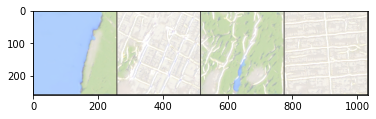

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 19: Step 10600: Generator (U-Net) loss: 11.414569432735448, Discriminator loss: 0.1353377224970609


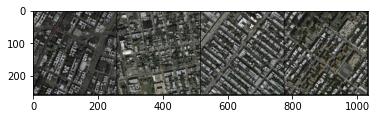

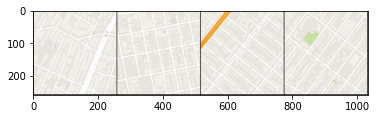

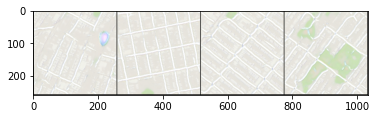

Epoch 19: Step 10800: Generator (U-Net) loss: 10.752573728561392, Discriminator loss: 0.23644837785512218


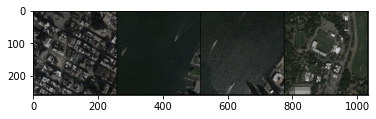

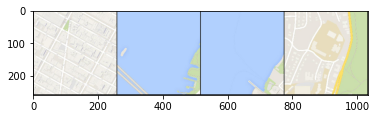

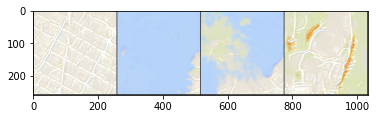

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 20: Step 11000: Generator (U-Net) loss: 10.858310120105743, Discriminator loss: 0.23491674211807545


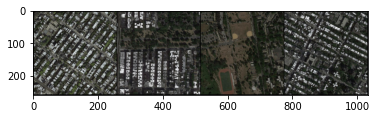

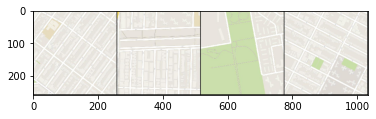

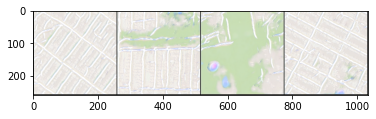

Epoch 20: Step 11200: Generator (U-Net) loss: 11.023993005752555, Discriminator loss: 0.21448537494987252


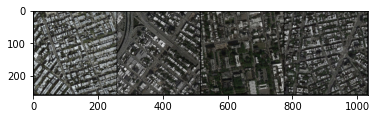

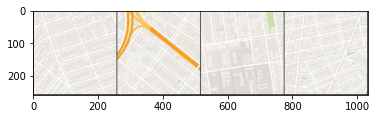

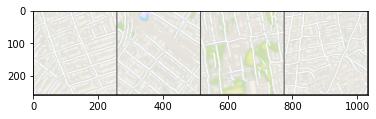

Epoch 20: Step 11400: Generator (U-Net) loss: 10.591933858394624, Discriminator loss: 0.2725735108181834


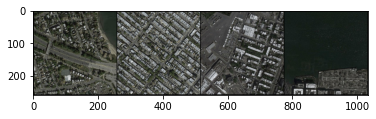

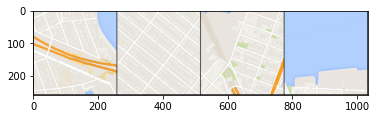

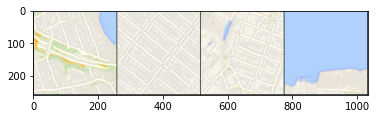

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 21: Step 11600: Generator (U-Net) loss: 10.747946805953982, Discriminator loss: 0.21357881576754156


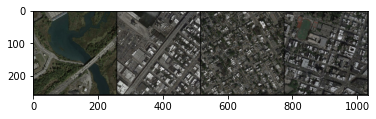

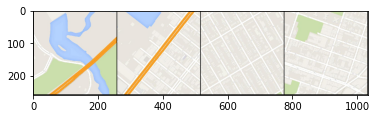

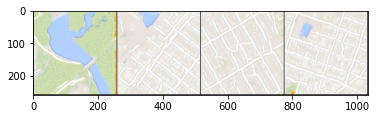

Epoch 21: Step 11800: Generator (U-Net) loss: 10.91897136211395, Discriminator loss: 0.22931695003993816


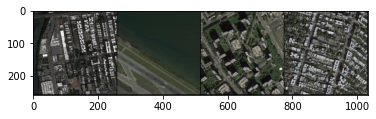

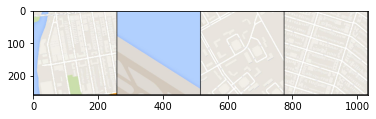

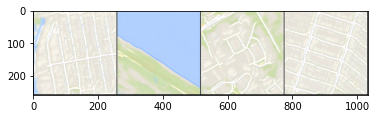

Epoch 21: Step 12000: Generator (U-Net) loss: 10.68895113706589, Discriminator loss: 0.2462461570231243


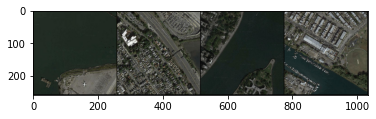

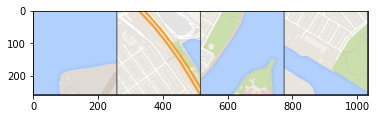

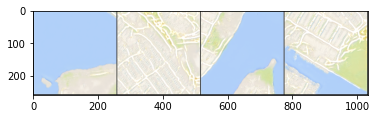

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 22: Step 12200: Generator (U-Net) loss: 11.283353149890903, Discriminator loss: 0.21408537835348396


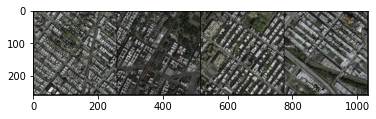

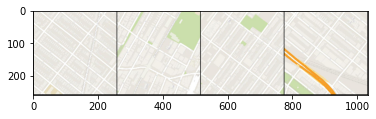

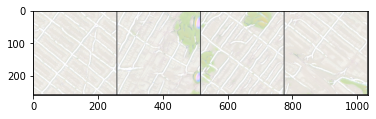

Epoch 22: Step 12400: Generator (U-Net) loss: 10.884410753250132, Discriminator loss: 0.23275438978802435


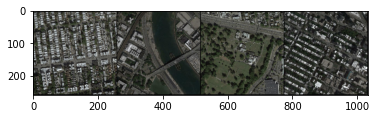

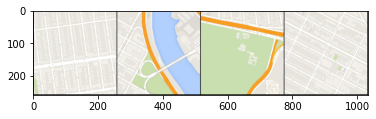

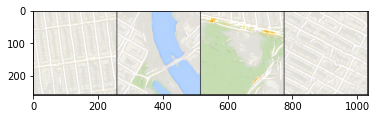

Epoch 22: Step 12600: Generator (U-Net) loss: 10.619221861362462, Discriminator loss: 0.19987728066276747


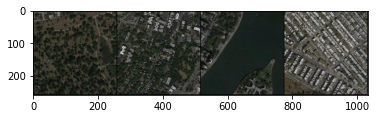

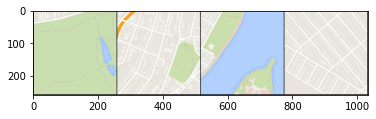

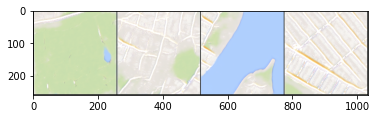

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 23: Step 12800: Generator (U-Net) loss: 11.193182227611537, Discriminator loss: 0.18723176427185534


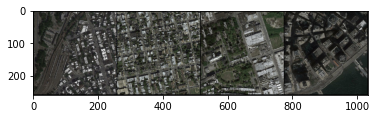

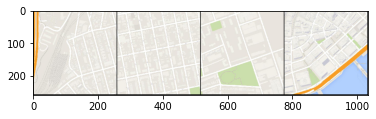

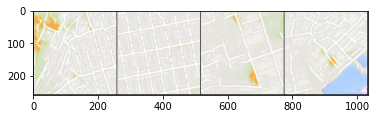

Epoch 23: Step 13000: Generator (U-Net) loss: 11.178658492565152, Discriminator loss: 0.21983378733508271


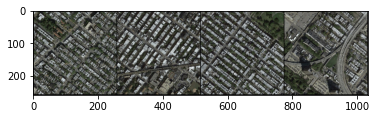

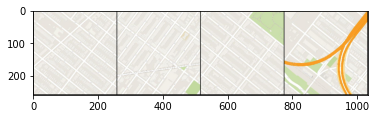

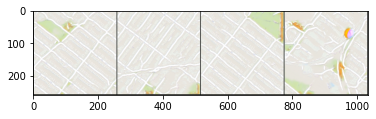

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 24: Step 13200: Generator (U-Net) loss: 11.36608690261841, Discriminator loss: 0.15971645513549443


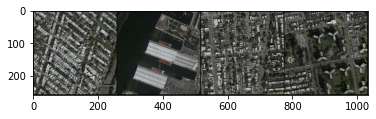

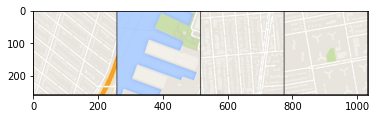

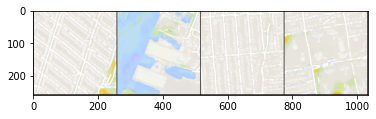

Epoch 24: Step 13400: Generator (U-Net) loss: 11.20029580354691, Discriminator loss: 0.15296362343244244


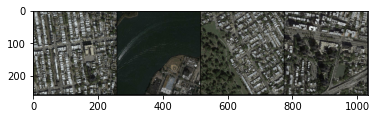

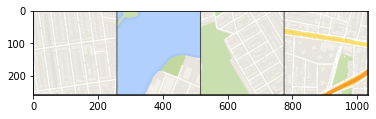

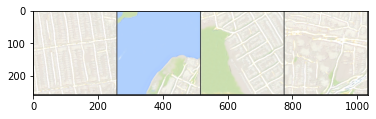

Epoch 24: Step 13600: Generator (U-Net) loss: 11.188136076927185, Discriminator loss: 0.17395105868577954


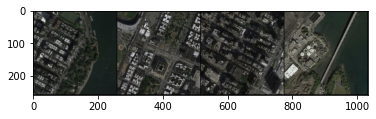

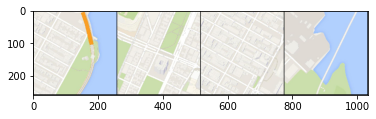

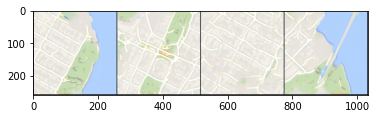

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 25: Step 13800: Generator (U-Net) loss: 11.137219219207768, Discriminator loss: 0.22272508459165685


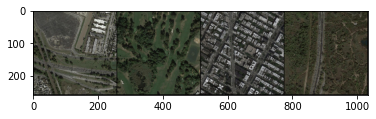

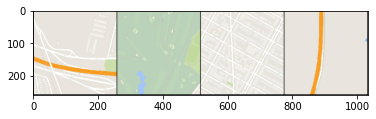

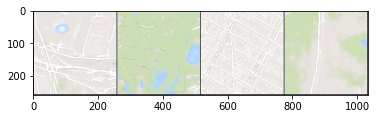

Epoch 25: Step 14000: Generator (U-Net) loss: 11.088582909107211, Discriminator loss: 0.2088391512259841


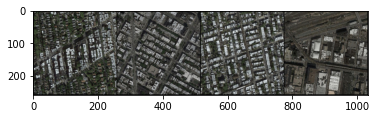

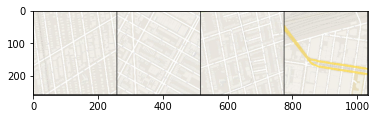

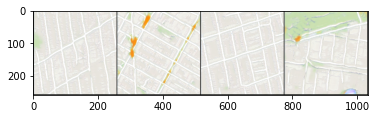

Epoch 25: Step 14200: Generator (U-Net) loss: 11.374618792533877, Discriminator loss: 0.15913239305838947


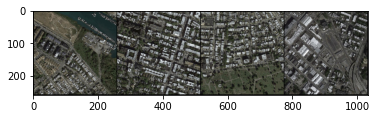

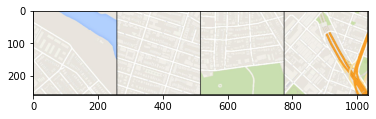

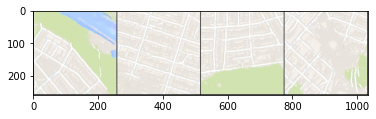

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 26: Step 14400: Generator (U-Net) loss: 11.174275960922234, Discriminator loss: 0.16386479174252608


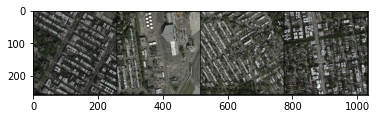

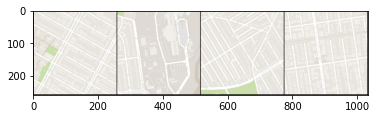

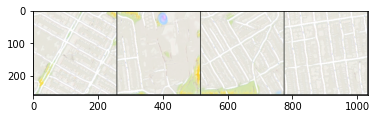

Epoch 26: Step 14600: Generator (U-Net) loss: 11.467998631000523, Discriminator loss: 0.13921737487427888


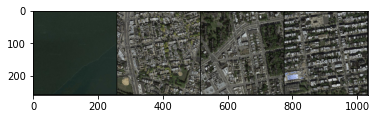

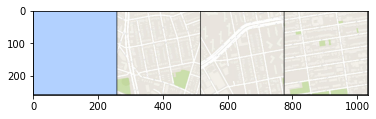

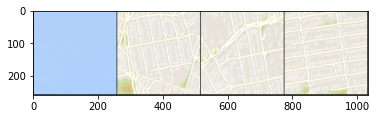

Epoch 26: Step 14800: Generator (U-Net) loss: 11.614369952678683, Discriminator loss: 0.16085535896476366


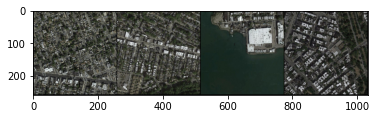

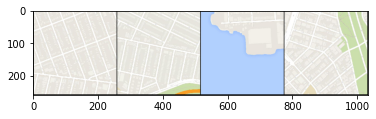

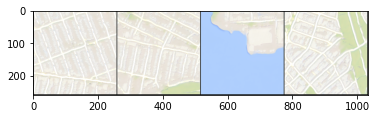

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 27: Step 15000: Generator (U-Net) loss: 11.240638828277586, Discriminator loss: 0.16904121709521855


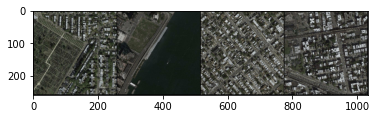

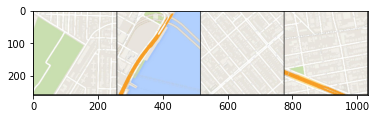

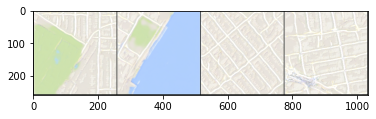

Epoch 27: Step 15200: Generator (U-Net) loss: 11.515286393165583, Discriminator loss: 0.15583654792048035


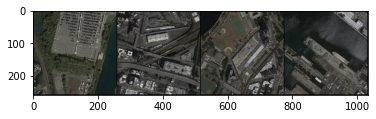

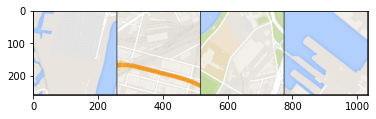

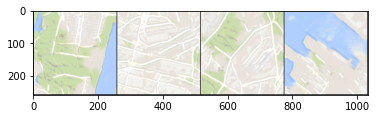

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 28: Step 15400: Generator (U-Net) loss: 11.376635649204246, Discriminator loss: 0.15867445242591202


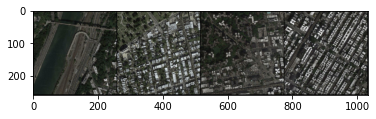

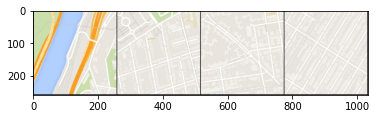

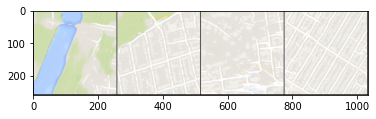

Epoch 28: Step 15600: Generator (U-Net) loss: 11.054882242679593, Discriminator loss: 0.18939500722568486


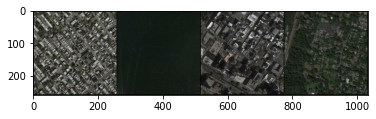

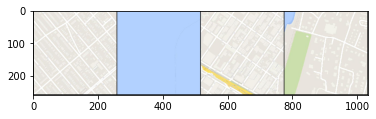

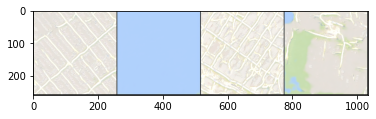

Epoch 28: Step 15800: Generator (U-Net) loss: 11.40099500894546, Discriminator loss: 0.19983009606134142


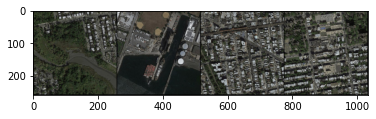

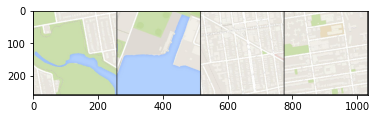

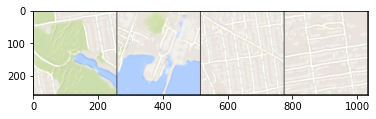

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 29: Step 16000: Generator (U-Net) loss: 11.007432498931879, Discriminator loss: 0.16291387775912883


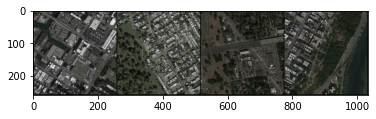

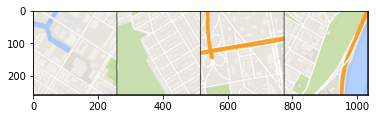

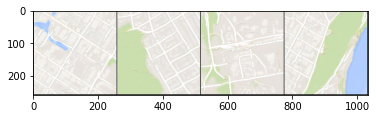

Epoch 29: Step 16200: Generator (U-Net) loss: 11.462816438674931, Discriminator loss: 0.1643029681267218


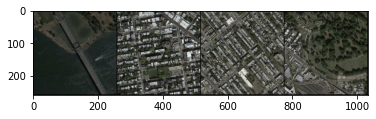

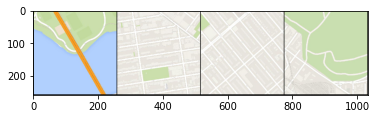

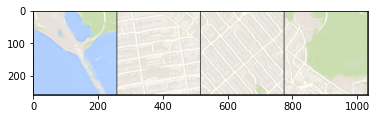

Epoch 29: Step 16400: Generator (U-Net) loss: 11.352250065803528, Discriminator loss: 0.13029778310563422


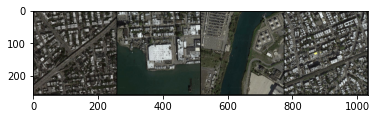

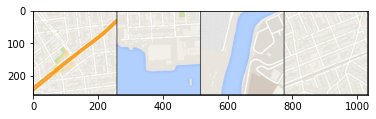

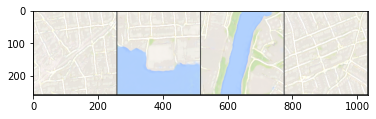

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 30: Step 16600: Generator (U-Net) loss: 11.269177284240715, Discriminator loss: 0.17137648954056217


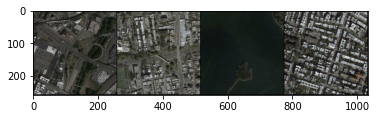

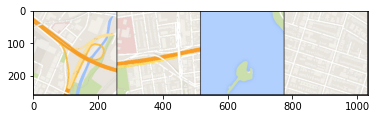

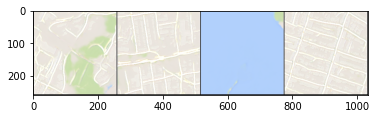

Epoch 30: Step 16800: Generator (U-Net) loss: 11.589379274845125, Discriminator loss: 0.10070562954060733


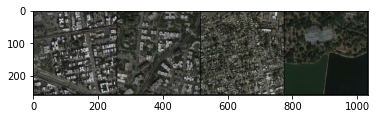

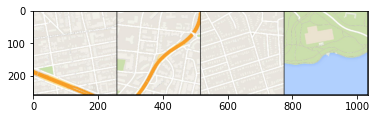

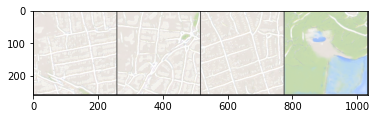

Epoch 30: Step 17000: Generator (U-Net) loss: 11.284198806285852, Discriminator loss: 0.19298116729129108


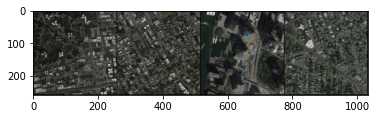

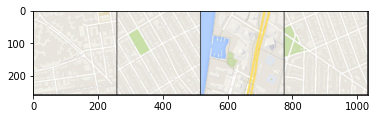

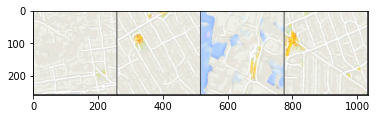

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 31: Step 17200: Generator (U-Net) loss: 11.539315781593324, Discriminator loss: 0.14789426662959165


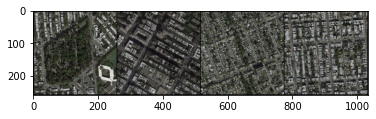

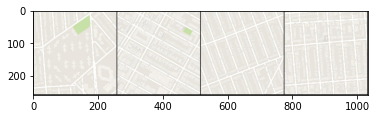

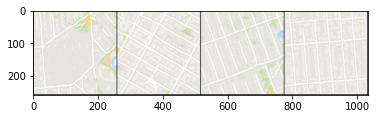

Epoch 31: Step 17400: Generator (U-Net) loss: 11.074527394771577, Discriminator loss: 0.1596777459094301


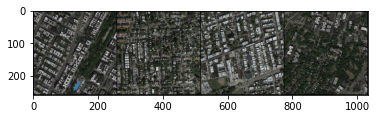

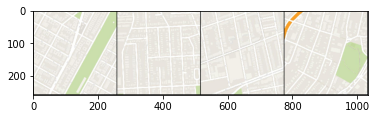

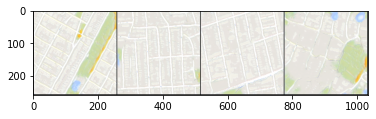

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 32: Step 17600: Generator (U-Net) loss: 11.532999010086062, Discriminator loss: 0.16080593177583075


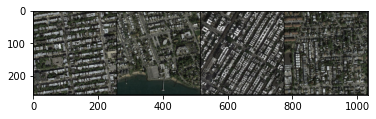

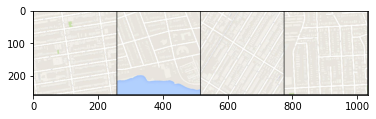

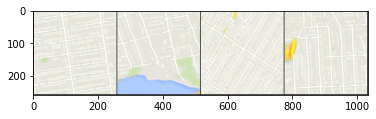

Epoch 32: Step 17800: Generator (U-Net) loss: 11.680701613426212, Discriminator loss: 0.1400940434634685


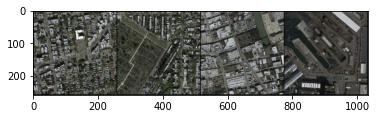

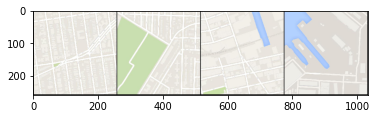

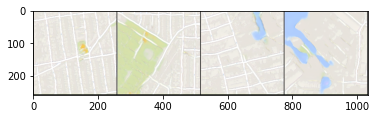

Epoch 32: Step 18000: Generator (U-Net) loss: 11.309394695758824, Discriminator loss: 0.1500769828725607


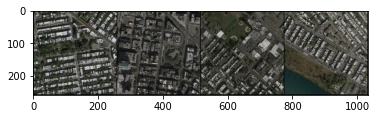

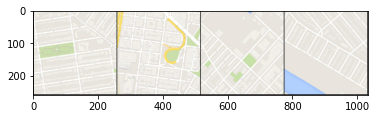

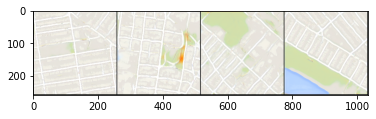

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 33: Step 18200: Generator (U-Net) loss: 11.10220507144928, Discriminator loss: 0.18737803651951268


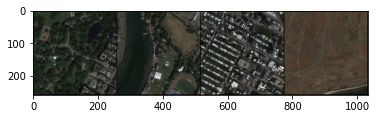

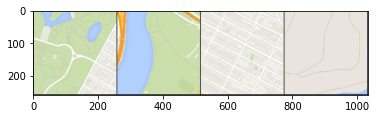

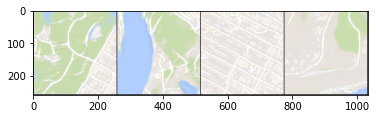

Epoch 33: Step 18400: Generator (U-Net) loss: 11.312464697360989, Discriminator loss: 0.15694633322302257


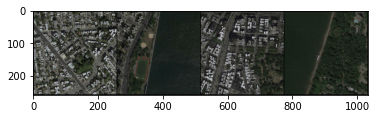

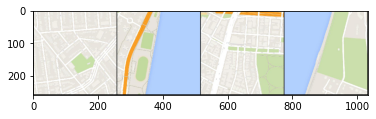

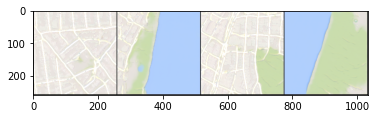

Epoch 33: Step 18600: Generator (U-Net) loss: 11.065980701446533, Discriminator loss: 0.16515815728809688


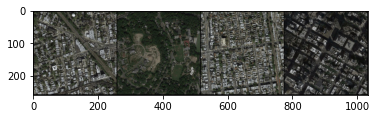

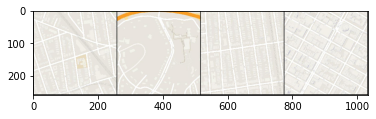

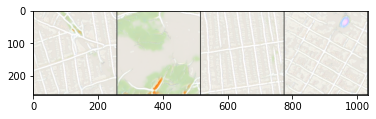

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 34: Step 18800: Generator (U-Net) loss: 11.449985094070437, Discriminator loss: 0.13310008624568587


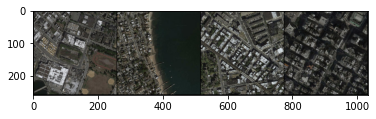

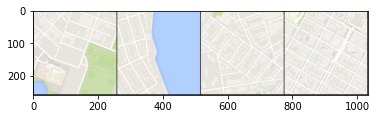

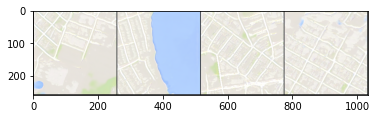

Epoch 34: Step 19000: Generator (U-Net) loss: 11.734432058334354, Discriminator loss: 0.12193873542360964


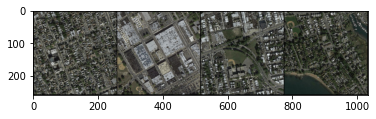

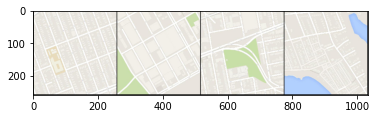

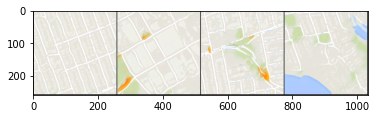

Epoch 34: Step 19200: Generator (U-Net) loss: 11.515473031997686, Discriminator loss: 0.1347393250418826


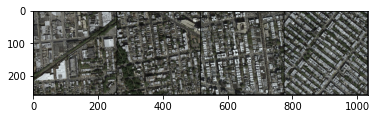

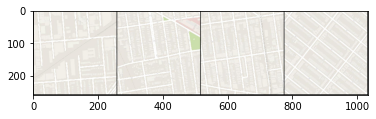

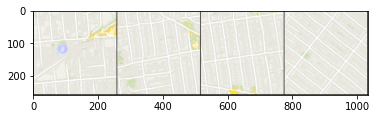

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 35: Step 19400: Generator (U-Net) loss: 11.50119612216949, Discriminator loss: 0.17508591996738676


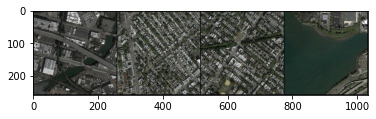

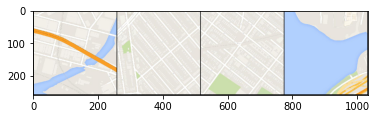

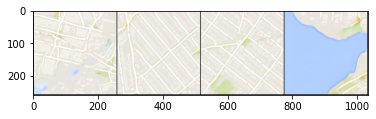

Epoch 35: Step 19600: Generator (U-Net) loss: 11.2657791852951, Discriminator loss: 0.17033869308419528


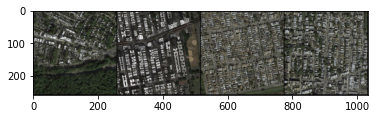

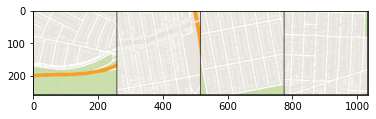

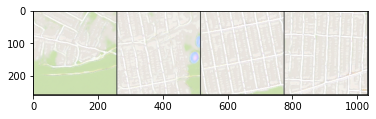

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 36: Step 19800: Generator (U-Net) loss: 11.33928622245789, Discriminator loss: 0.13921621484681962


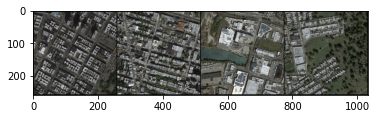

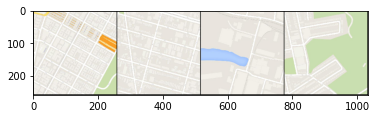

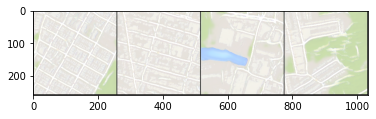

Epoch 36: Step 20000: Generator (U-Net) loss: 11.339423859119421, Discriminator loss: 0.12128184683388098


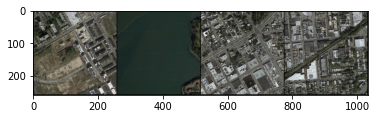

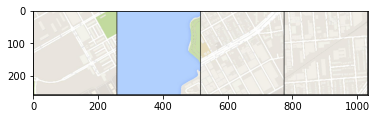

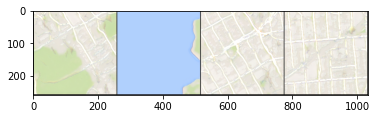

Epoch 36: Step 20200: Generator (U-Net) loss: 11.72213764190674, Discriminator loss: 0.1292410201346502


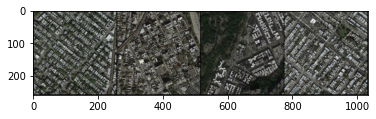

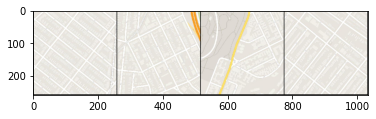

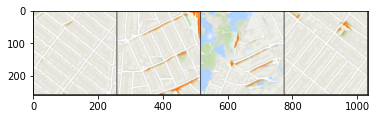

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 37: Step 20400: Generator (U-Net) loss: 12.15312579870224, Discriminator loss: 0.07519264692673464


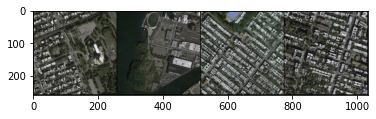

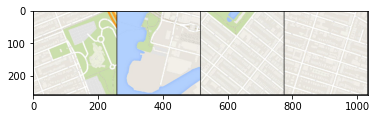

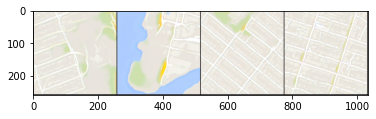

Epoch 37: Step 20600: Generator (U-Net) loss: 11.639522521495813, Discriminator loss: 0.1386074911546893


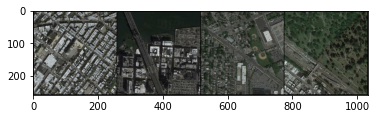

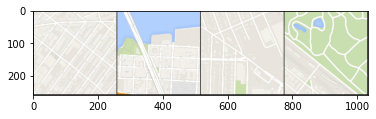

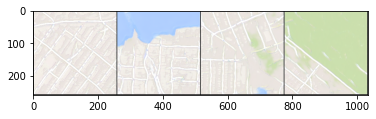

Epoch 37: Step 20800: Generator (U-Net) loss: 11.48885860204697, Discriminator loss: 0.15669836698565628


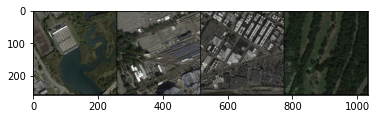

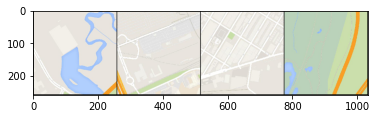

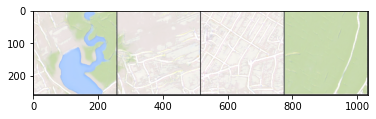

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 38: Step 21000: Generator (U-Net) loss: 11.382603034973146, Discriminator loss: 0.1381882103555836


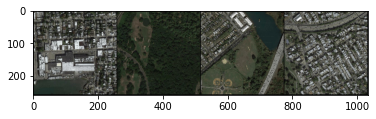

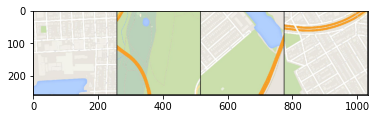

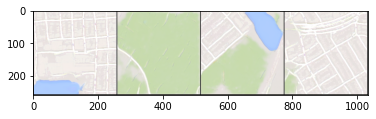

Epoch 38: Step 21200: Generator (U-Net) loss: 11.75547501564026, Discriminator loss: 0.14613780560437598


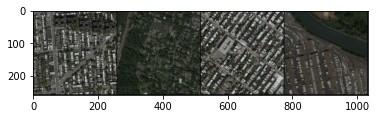

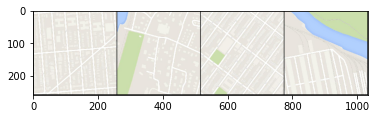

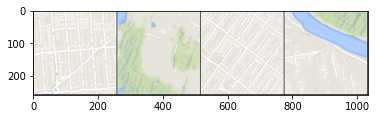

Epoch 38: Step 21400: Generator (U-Net) loss: 11.509485621452336, Discriminator loss: 0.14416034398833283


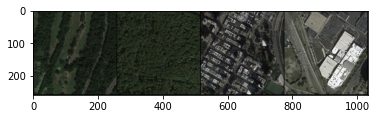

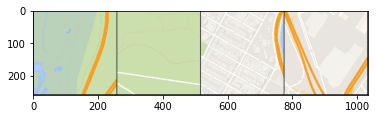

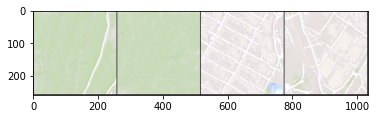

  0%|          | 0/549 [00:00<?, ?it/s]

Epoch 39: Step 21600: Generator (U-Net) loss: 11.488925642967224, Discriminator loss: 0.1334880874422378


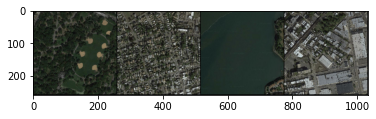

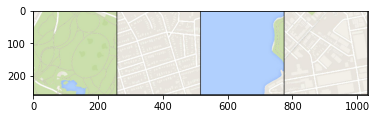

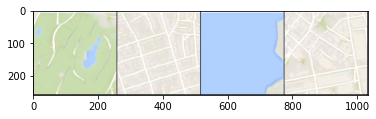

Epoch 39: Step 21800: Generator (U-Net) loss: 11.717585566043853, Discriminator loss: 0.14129671524744478


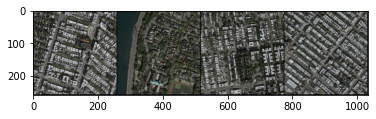

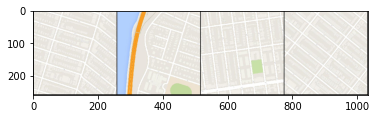

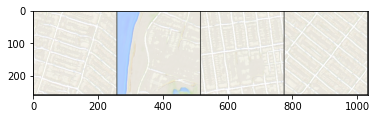

In [ ]:
from skimage import color
import numpy as np

def train(save_model=False):
    mean_generator_loss = 0
    mean_discriminator_loss = 0
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
    cur_step = 0

    for epoch in range(n_epochs):
        # Dataloader returns the batches
        for image, _ in tqdm(dataloader):
            image_width = image.shape[3]
            condition = image[:, :, :, :image_width // 2]
            condition = nn.functional.interpolate(condition, size=target_shape)
            real = image[:, :, :, image_width // 2:]
            real = nn.functional.interpolate(real, size=target_shape)
            cur_batch_size = len(condition)
            condition = condition.to(device)
            real = real.to(device)

            ### Update discriminator ###
            disc_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake = gen(condition)
            disc_fake_hat = disc(fake.detach(), condition) # Detach generator
            disc_fake_loss = adv_criterion(disc_fake_hat, torch.zeros_like(disc_fake_hat))
            disc_real_hat = disc(real, condition)
            disc_real_loss = adv_criterion(disc_real_hat, torch.ones_like(disc_real_hat))
            disc_loss = (disc_fake_loss + disc_real_loss) / 2
            disc_loss.backward(retain_graph=True) # Update gradients
            disc_opt.step() # Update optimizer

            ### Update generator ###
            gen_opt.zero_grad()
            gen_loss = get_gen_loss(gen, disc, real, condition, adv_criterion, recon_criterion, lambda_recon)
            gen_loss.backward() # Update gradients
            gen_opt.step() # Update optimizer

            # Keep track of the average discriminator loss
            mean_discriminator_loss += disc_loss.item() / display_step
            # Keep track of the average generator loss
            mean_generator_loss += gen_loss.item() / display_step

            ### Visualization code ###
            if cur_step % display_step == 0:
                if cur_step > 0:
                    print(f"Epoch {epoch}: Step {cur_step}: Generator (U-Net) loss: {mean_generator_loss}, Discriminator loss: {mean_discriminator_loss}")
                else:
                    print("Pretrained initial state")
                show_tensor_images(condition, size=(input_dim, target_shape, target_shape))
                show_tensor_images(real, size=(real_dim, target_shape, target_shape))
                show_tensor_images(fake, size=(real_dim, target_shape, target_shape))
                mean_generator_loss = 0
                mean_discriminator_loss = 0
                # We can change save_model to True if we'd like to save the model
                if save_model:
                    torch.save({'gen': gen.state_dict(),
                        'gen_opt': gen_opt.state_dict(),
                        'disc': disc.state_dict(),
                        'disc_opt': disc_opt.state_dict()
                    }, f"pix2pix_{cur_step}.pth")
            cur_step += 1
n_epochs = 40
train(save_model=True)